# MODULE 2 : XAI

---

### libraries

In [1]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from collections import defaultdict

from sklearn.preprocessing import MinMaxScaler

from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelEncoder, label_binarize
from sklearn.tree import plot_tree

from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import AdaBoostClassifier

from lime.lime_tabular import LimeTabularExplainer
from xailib.explainers.lore_explainer import LoreTabularExplainer
from xailib.models.sklearn_classifier_wrapper import sklearn_classifier_wrapper
import shap
import fatf.transparency.predictions.counterfactuals as fatf_cf

25-May-06 14:46:12 fatf.utils.array.tools INFO     Using numpy's numpy.lib.recfunctions.structured_to_unstructured as fatf.utils.array.tools.structured_to_unstructured and fatf.utils.array.tools.structured_to_unstructured_row.


---

### 0) Data Visualization

dataset completo preprocessed -> Target variable: **groupedRating = [3, 4, 5, 6, 7, 8, 9]**

In [5]:
# =============================================================================
# PART 1.1: Data Loading, Preprocessing & Normalization (Normal Preprocessed Dataset)
# =============================================================================

# 1. Load the preprocessed train and test datasets from CSV
train_data_preprocessed = pd.read_csv("../../../0) dataset/1) preprocessed dataset/train_preprocessed.csv")
test_data_preprocessed  = pd.read_csv("../../../0) dataset/1) preprocessed dataset/test_preprocessed.csv")

# Drop the 'Unnamed: 0' column if it exists
train_data_preprocessed.drop(columns='Unnamed: 0', inplace=True, errors='ignore')
test_data_preprocessed.drop(columns='Unnamed: 0', inplace=True, errors='ignore')

# 2. Map the original "rating" into the new target "groupedRating"
def map_rating(r):
    # Map ratings 0, 1, 2, and 3 to 3; leave other ratings unchanged.
    if r in [0, 1, 2, 3]:
        return 3
    else:
        return r

train_data_preprocessed["groupedRating"] = train_data_preprocessed["rating"].apply(map_rating)
test_data_preprocessed["groupedRating"]  = test_data_preprocessed["rating"].apply(map_rating)

# Define the new target variable
target = "groupedRating"

# 3. Extract numerical columns dynamically from the training set
attributes = list(np.unique(train_data_preprocessed.select_dtypes(include=['int', 'float64']).columns))

# Remove dangerous features: remove the original "rating" and the target "groupedRating"
unwanted_values = {'rating', 'groupedRating', 'averageRating'}
attributes = [attr for attr in attributes if attr not in unwanted_values]
print("Initial numerical features:", attributes)

# 4. Define the feature matrix (X) and target vector (y) for both train and test sets
# Use new variable names to avoid conflict with outliers removed dataset
X_train_preprocessed = train_data_preprocessed[attributes].values
y_train_preprocessed = train_data_preprocessed[target].values

X_test_preprocessed  = test_data_preprocessed[attributes].values
y_test_preprocessed  = test_data_preprocessed[target].values

# 5. Normalize the features using StandardScaler
scaler_preprocessed = MinMaxScaler()
X_train_scaled_preprocessed = scaler_preprocessed.fit_transform(X_train_preprocessed)
X_test_scaled_preprocessed  = scaler_preprocessed.transform(X_test_preprocessed)

Initial numerical features: ['Action', 'Adventure', 'Animation', 'Asia', 'Australia/Oceania', 'Comedy', 'Crime', 'Documentary', 'Drama', 'Europe', 'Middle East', 'North Africa', 'North America', 'Series', 'Short', 'South Africa', 'South America', 'awardNominationsExcludeWinsLog', 'awardWinsLog', 'castNumberLog', 'companiesNumberLog', 'criticReviewsTotalLog', 'directorsCreditsLog', 'externalLinksLog', 'isAdult', 'movie', 'numRegionsLog', 'numVotesLog', 'other', 'others', 'quotesTotalLog', 'runtimeMinutes', 'short', 'startYear', 'totalCreditsLog', 'totalImagesLog', 'totalVideosLog', 'userReviewsTotalLog', 'writerCreditsLog']


### 1) Neural Network VS Bagging VS Boosting - Black Box

Classification Report:
               precision    recall  f1-score   support

           3       0.50      0.14      0.22      1585
           4       0.38      0.13      0.19      2688
           5       0.38      0.30      0.34      6279
           6       0.42      0.46      0.44     11696
           7       0.47      0.70      0.57     14657
           8       0.45      0.24      0.32      6677
           9       0.64      0.14      0.23      1278

    accuracy                           0.44     44860
   macro avg       0.46      0.30      0.33     44860
weighted avg       0.44      0.44      0.42     44860



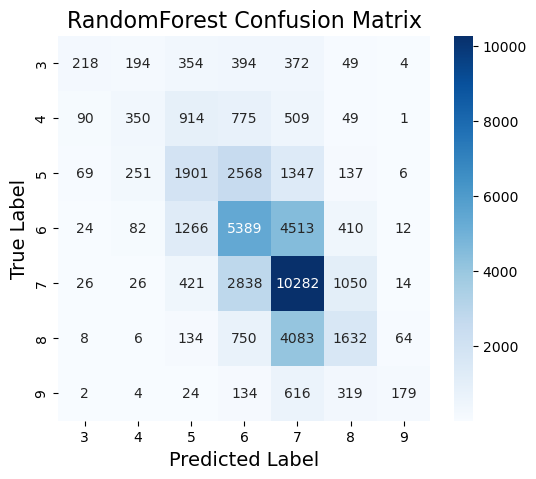

In [3]:
# =============================================================================
# PART 4: RandomForestClassifier - Black Box
# =============================================================================

# --- Step 1: Model Initialization and Training ---
rf_model = RandomForestClassifier(n_estimators=300, criterion='entropy', max_depth=None, min_samples_split=2, min_samples_leaf=1, random_state=42, n_jobs=-1)
rf_model.fit(X_train_scaled_preprocessed, y_train_preprocessed)
y_pred_rf = rf_model.predict(X_test_scaled_preprocessed)

# --- Step 2: Classification Report ---
print("Classification Report:\n", classification_report(y_test_preprocessed, y_pred_rf))

# --- Step 3: Confusion Matrix ---
cm_rf = confusion_matrix(y_test_preprocessed, y_pred_rf)
plt.figure(figsize=(6, 5))
sns.heatmap(cm_rf, annot=True, fmt="d", cmap="Blues", xticklabels=np.unique(y_train_preprocessed), yticklabels=np.unique(y_train_preprocessed))
plt.xlabel('Predicted Label', fontsize=14)
plt.ylabel('True Label', fontsize=14)
plt.title('RandomForest Confusion Matrix', fontsize=16)
plt.show()

Classification Report:
               precision    recall  f1-score   support

           3       0.45      0.10      0.16      1585
           4       0.41      0.08      0.13      2688
           5       0.39      0.28      0.32      6279
           6       0.40      0.33      0.37     11696
           7       0.47      0.57      0.51     14657
           8       0.23      0.41      0.29      6677
           9       0.24      0.02      0.04      1278

    accuracy                           0.38     44860
   macro avg       0.37      0.26      0.26     44860
weighted avg       0.39      0.38      0.37     44860



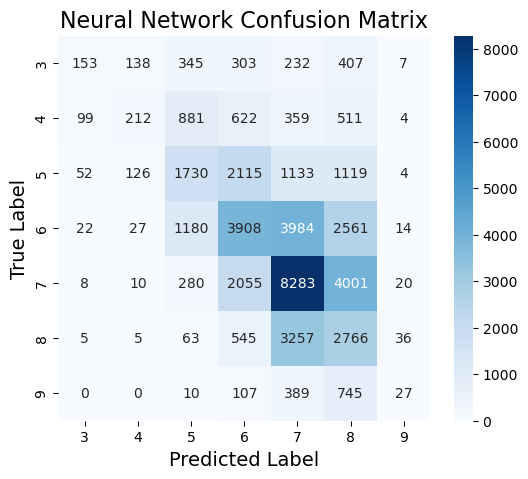

In [4]:
# =============================================================================
# PART 3: Neural Network for Grouped Rating Prediction
# =============================================================================

# --- Step 1: Neural Network Fit and Predict ---
nn_model = MLPClassifier(hidden_layer_sizes=(128, 64, 32), random_state=42, early_stopping=True)
nn_model.fit(X_train_scaled_preprocessed, y_train_preprocessed)
y_pred_nn = nn_model.predict(X_test_scaled_preprocessed)

# --- Step 2: classification report ---
print("Classification Report:\n", classification_report(y_test_preprocessed, y_pred_nn))

# --- Step 3: Confusion Matrix
cm_nn = confusion_matrix(y_test_preprocessed, y_pred_nn)
plt.figure(figsize=(6, 5))
sns.heatmap(cm_nn, annot=True, fmt="d", cmap="Blues", xticklabels=np.unique(y_train_preprocessed), yticklabels=np.unique(y_train_preprocessed))
plt.xlabel('Predicted Label', fontsize=14)
plt.ylabel('True Label', fontsize=14)
plt.title('Neural Network Confusion Matrix', fontsize=16)
plt.show()

Classification Report:
               precision    recall  f1-score   support

           3       0.53      0.14      0.22      1585
           4       0.39      0.14      0.20      2688
           5       0.38      0.31      0.34      6279
           6       0.42      0.46      0.44     11696
           7       0.48      0.70      0.57     14657
           8       0.44      0.25      0.32      6677
           9       0.63      0.13      0.21      1278

    accuracy                           0.45     44860
   macro avg       0.47      0.30      0.33     44860
weighted avg       0.44      0.45      0.42     44860



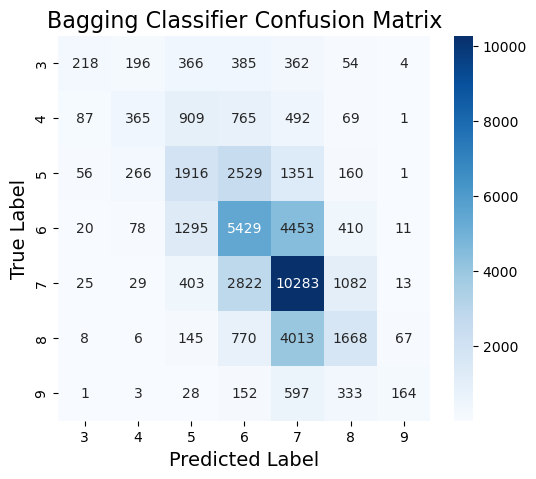

In [5]:
# =============================================================================
# PART 5: BaggingClassifier - Black Box
# =============================================================================

# --- Step 1: Model Initialization and Training - Trying to mimic the 'RandomForestClassifier' model ---
bag_model = BaggingClassifier(estimator=DecisionTreeClassifier(max_features=int(np.sqrt(X_train_scaled_preprocessed.shape[1])), random_state=42), n_estimators=300, random_state=42, n_jobs=-1)
bag_model.fit(X_train_scaled_preprocessed, y_train_preprocessed)
y_pred_bag = bag_model.predict(X_test_scaled_preprocessed)

# --- Step 2: Classification Report ---
print("Classification Report:\n", classification_report(y_test_preprocessed, y_pred_bag))

# --- Step 3: Confusion Matrix ---
cm_bag = confusion_matrix(y_test_preprocessed, y_pred_bag)
plt.figure(figsize=(6, 5))
sns.heatmap(cm_bag, annot=True, fmt="d", cmap="Blues", xticklabels=np.unique(y_train_preprocessed), yticklabels=np.unique(y_train_preprocessed))
plt.xlabel('Predicted Label', fontsize=14)
plt.ylabel('True Label', fontsize=14)
plt.title('Bagging Classifier Confusion Matrix', fontsize=16)
plt.show()

Classification Report:
               precision    recall  f1-score   support

           3       0.56      0.15      0.23      1585
           4       0.42      0.14      0.21      2688
           5       0.38      0.31      0.34      6279
           6       0.42      0.48      0.45     11696
           7       0.48      0.70      0.57     14657
           8       0.48      0.24      0.32      6677
           9       0.63      0.15      0.24      1278

    accuracy                           0.45     44860
   macro avg       0.48      0.31      0.34     44860
weighted avg       0.45      0.45      0.43     44860



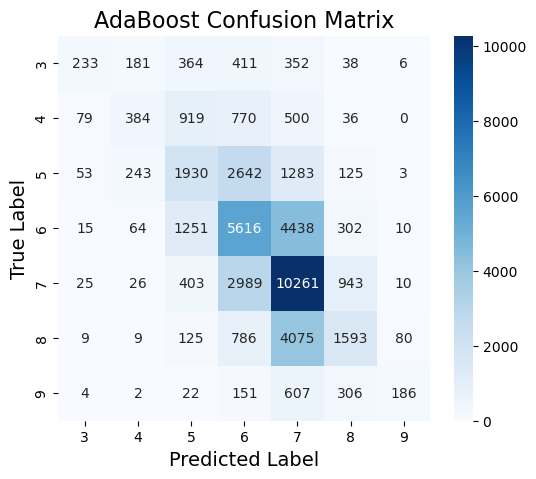

In [6]:
# =============================================================================
# PART 6: AdaBoostClassifier for Grouped Rating Prediction
# =============================================================================

# --- Step 1: Model Initialization and Training ---
ada_model = AdaBoostClassifier(estimator=RandomForestClassifier(n_estimators=100, criterion='entropy', random_state=42, n_jobs=-1), n_estimators=10, learning_rate=1.3, random_state=42)
ada_model.fit(X_train_scaled_preprocessed, y_train_preprocessed)
y_pred_ada = ada_model.predict(X_test_scaled_preprocessed)

# --- Step 2: Classification Report ---
print("Classification Report:\n", classification_report(y_test_preprocessed, y_pred_ada))

# --- Step 2: Confusion Matrix ---
cm_ada = confusion_matrix(y_test_preprocessed, y_pred_ada)
plt.figure(figsize=(6, 5))
sns.heatmap(cm_ada, annot=True, fmt="d", cmap="Blues", xticklabels=np.unique(y_train_preprocessed), yticklabels=np.unique(y_train_preprocessed))
plt.xlabel('Predicted Label', fontsize=14)
plt.ylabel('True Label', fontsize=14)
plt.title('AdaBoost Confusion Matrix', fontsize=16)
plt.show()

In [7]:
# =============================================================================
# Recap “Worst” 3→9 and 9→3 Errors for All 11 Classifiers
# =============================================================================

# 1. Dictionary mapping each model name to its precomputed predictions
y_preds = {
    "NeuralNetwork":         y_pred_nn,
    "BaggingClassifier":     y_pred_bag,
    "RandomForest":          y_pred_rf,
    "AdaBoostClassifier":    y_pred_ada
}

# 2. Loop over each model’s predictions and report the “corner” errors
for name, y_pred in y_preds.items():
    idx_3_to_9 = np.where((y_test_preprocessed == 3) & (y_pred == 9))[0]
    idx_9_to_3 = np.where((y_test_preprocessed == 9) & (y_pred == 3))[0]

    print(f"\n=== {name} ===")
    print(f" true=3 → pred=9  ({len(idx_3_to_9)} samples):")
    for idx in idx_3_to_9:
        print(f"   idx={idx:5d} | true=3 → pred=9")

    print(f" true=9 → pred=3  ({len(idx_9_to_3)} samples):")
    for idx in idx_9_to_3:
        print(f"   idx={idx:5d} | true=9 → pred=3")


=== NeuralNetwork ===
 true=3 → pred=9  (7 samples):
   idx=  275 | true=3 → pred=9
   idx= 1376 | true=3 → pred=9
   idx= 2229 | true=3 → pred=9
   idx=10144 | true=3 → pred=9
   idx=13168 | true=3 → pred=9
   idx=18588 | true=3 → pred=9
   idx=26390 | true=3 → pred=9
 true=9 → pred=3  (0 samples):

=== BaggingClassifier ===
 true=3 → pred=9  (4 samples):
   idx=16293 | true=3 → pred=9
   idx=18528 | true=3 → pred=9
   idx=24362 | true=3 → pred=9
   idx=38615 | true=3 → pred=9
 true=9 → pred=3  (1 samples):
   idx=  376 | true=9 → pred=3

=== RandomForest ===
 true=3 → pred=9  (4 samples):
   idx=12600 | true=3 → pred=9
   idx=16293 | true=3 → pred=9
   idx=18528 | true=3 → pred=9
   idx=24362 | true=3 → pred=9
 true=9 → pred=3  (2 samples):
   idx= 1566 | true=9 → pred=3
   idx= 2420 | true=9 → pred=3

=== AdaBoostClassifier ===
 true=3 → pred=9  (6 samples):
   idx=  927 | true=3 → pred=9
   idx= 3199 | true=3 → pred=9
   idx= 3753 | true=3 → pred=9
   idx=16293 | true=3 → pred=9
 

In [8]:
# =============================================================================
# Find records misclassified by more than one model in the “3→9” or “9→3” corners
# =============================================================================

# 1. Build a mapping: test‐index → list of (model_name, error_type)
mis_map = defaultdict(list)

for name, y_pred in y_preds.items():
    # 3→9 errors
    for idx in np.where((y_test_preprocessed == 3) & (y_pred == 9))[0]:
        mis_map[idx].append((name, "3→9"))
    # 9→3 errors
    for idx in np.where((y_test_preprocessed == 9) & (y_pred == 3))[0]:
        mis_map[idx].append((name, "9→3"))

# 2. Filter to only those indices misclassified by more than one model
shared_errors = {idx: errs for idx, errs in mis_map.items() if len(errs) > 1}

# 3. Print the overlaps
print("Indices misclassified by multiple models in the extreme corners:\n")
for idx, errs in sorted(shared_errors.items()):
    models_and_types = ", ".join(f"{m}({t})" for m, t in errs)
    print(f"  idx={idx:5d}  →  {models_and_types}")

Indices misclassified by multiple models in the extreme corners:

  idx= 1566  →  RandomForest(9→3), AdaBoostClassifier(9→3)
  idx= 2420  →  RandomForest(9→3), AdaBoostClassifier(9→3)
  idx=16293  →  BaggingClassifier(3→9), RandomForest(3→9), AdaBoostClassifier(3→9)
  idx=18528  →  BaggingClassifier(3→9), RandomForest(3→9), AdaBoostClassifier(3→9)
  idx=24362  →  BaggingClassifier(3→9), RandomForest(3→9), AdaBoostClassifier(3→9)


---

### 2) XAI

**XAI Methods Meanings**:
- **LIME** → Why did we get class 7 for this one sample?
- **SHAP** → Which features matter most overall and how they push each prediction.
- **LORE** → Readable rules (“if A and B then 7”) and contrastive rules (“to get 8, change C”).
- **Counterfactuals** → What minimal tweaks lead to a different rating.

### 2.1) SHAP

[shap](https://shap.readthedocs.io/en/latest/api.html)

Using 1000 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


Stratified sample counts per class:
label
3    50
4    50
5    50
6    50
7    50
8    50
9    50
Name: count, dtype: int64


  0%|          | 0/350 [00:00<?, ?it/s]

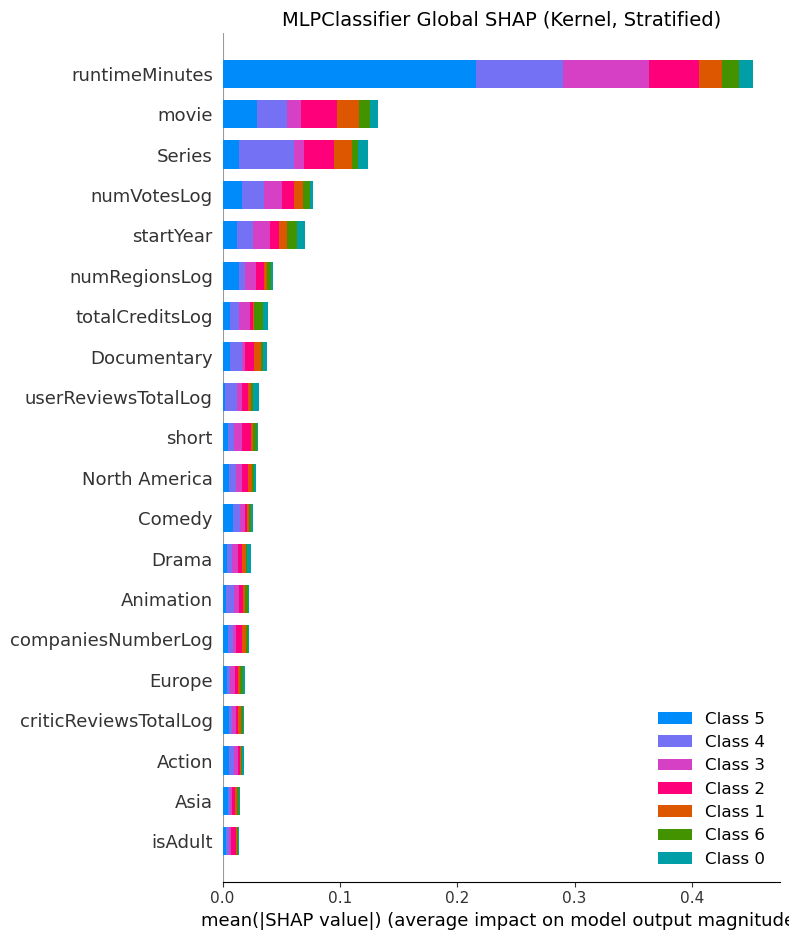

In [ ]:
# =============================================================================
# PART X: Class-Balanced SHAP Importances via KernelExplainer for All Three Models
# =============================================================================

# 0. Build a compact background of 10 centroids from your train set
background = shap.kmeans(X_train_scaled_preprocessed, 10)

# 1. Stratified sampling: up to 50 rows per true class
df_test = pd.DataFrame(X_test_scaled_preprocessed, columns=attributes)
df_test['label'] = y_test_preprocessed

per_class = 50
df_strat = (df_test.groupby('label', group_keys=False).apply(lambda grp: grp.sample(n=min(len(grp), per_class), random_state=42)).reset_index(drop=True))

X_test_strat = df_strat[attributes].values
y_test_strat = df_strat['label'].values

print("Stratified sample counts per class:")
print(df_strat['label'].value_counts())

# 2. SHAP parameter
nsamples = 100

# -----------------------------------------------------------------------------
# A) Neural Network (MLPClassifier) via KernelExplainer
# -----------------------------------------------------------------------------
explainer_nn = shap.KernelExplainer(nn_model.predict_proba, background)
shap_values_nn = explainer_nn.shap_values(X_test_strat, nsamples=nsamples)

plt.figure(figsize=(6,4))
shap.summary_plot(
    shap_values_nn,
    X_test_strat,
    feature_names=attributes,
    plot_type="bar",
    show=False
)
plt.title("MLPClassifier Global SHAP (Kernel, Stratified)", fontsize=14)
plt.tight_layout()

# -----------------------------------------------------------------------------
# B) RandomForestClassifier via KernelExplainer
# -----------------------------------------------------------------------------
explainer_rf = shap.KernelExplainer(rf_model.predict_proba, background)
shap_values_rf = explainer_rf.shap_values(X_test_strat, nsamples=nsamples)

plt.figure(figsize=(6,4))
shap.summary_plot(
    shap_values_rf,
    X_test_strat,
    feature_names=attributes,
    plot_type="bar",
    show=False
)
plt.title("RandomForestClassifier Global SHAP (Kernel, Stratified)", fontsize=14)
plt.tight_layout()

# -----------------------------------------------------------------------------
# C) AdaBoostClassifier via KernelExplainer
# -----------------------------------------------------------------------------
explainer_ada = shap.KernelExplainer(ada_model.predict_proba, background)
shap_values_ada = explainer_ada.shap_values(X_test_strat, nsamples=nsamples)

plt.figure(figsize=(6,4))
shap.summary_plot(
    shap_values_ada,
    X_test_strat,
    feature_names=attributes,
    plot_type="bar",
    show=False
)
plt.title("AdaBoostClassifier Global SHAP (Kernel, Stratified)", fontsize=14)
plt.tight_layout()

plt.show()

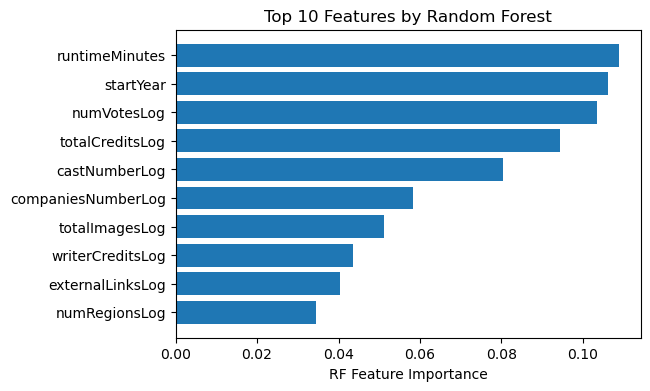

In [10]:
importances = rf_model.feature_importances_
indices = np.argsort(importances)[::-1][:10]
top_features = [attributes[i] for i in indices]

plt.figure(figsize=(6,4))
plt.barh([attributes[i] for i in indices][::-1], importances[indices][::-1])
plt.xlabel("RF Feature Importance")
plt.title("Top 10 Features by Random Forest")
plt.show()

### 2.2) LIME

In [11]:
# =============================================================================
# PART X: LIME Contrastive Explanations on Shared “3→9” Errors for RF & AdaBoost
# =============================================================================

# 1. Shared misclassified indices (extreme corner flips)
shared_idxs = [16293, 18528, 24362]

# 2. Common setup for LIME
classes     = sorted(np.unique(y_train_preprocessed))   # [3,4,5,6,7,8,9]
class_names = [str(c) for c in classes]
lime_explainer = LimeTabularExplainer(training_data=X_train_scaled_preprocessed, feature_names=attributes, class_names=class_names, mode='classification', discretize_continuous=False, random_state=42)

# 3. Loop over Random Forest and AdaBoost
for model_name, model in [("RandomForestClassifier", rf_model), ("AdaBoostClassifier", ada_model)]:
    print(f"\n=== LIME Explanations for {model_name} ===")
    for idx in shared_idxs:
        true_lbl = y_test_preprocessed[idx]
        pred_lbl = model.predict(X_test_scaled_preprocessed[idx].reshape(1, -1))[0]
        # only explain 3→9 or 9→3 flips
        if not ((true_lbl == 3 and pred_lbl == 9) or (true_lbl == 9 and pred_lbl == 3)):
            continue
        
        label_idx_pred = classes.index(pred_lbl)
        label_idx_true = classes.index(true_lbl)
        inst = X_test_scaled_preprocessed[idx]
        
        print(f"\n-- idx={idx} | true={true_lbl} → pred={pred_lbl} --")
        
        # A) Why did it predict the wrong class?
        exp_pred = lime_explainer.explain_instance(data_row=inst, predict_fn=model.predict_proba, labels=[label_idx_pred], num_features=8)
        print(f"\nLIME: Why {pred_lbl}?")
        exp_pred.show_in_notebook(labels=(label_idx_pred,), show_table=True)
        
        # B) Why not the true class?
        exp_true = lime_explainer.explain_instance(data_row=inst, predict_fn=model.predict_proba, labels=[label_idx_true], num_features=8)
        print(f"\nLIME: Why not {true_lbl}?")
        exp_true.show_in_notebook(labels=(label_idx_true,), show_table=True)


=== LIME Explanations for RandomForestClassifier ===

-- idx=16293 | true=3 → pred=9 --

LIME: Why 9?



LIME: Why not 3?



-- idx=18528 | true=3 → pred=9 --

LIME: Why 9?



LIME: Why not 3?



-- idx=24362 | true=3 → pred=9 --

LIME: Why 9?



LIME: Why not 3?



=== LIME Explanations for AdaBoostClassifier ===

-- idx=16293 | true=3 → pred=9 --

LIME: Why 9?



LIME: Why not 3?



-- idx=18528 | true=3 → pred=9 --

LIME: Why 9?



LIME: Why not 3?



-- idx=24362 | true=3 → pred=9 --

LIME: Why 9?



LIME: Why not 3?


### 2.3) LORE

In [12]:
"""
# 1. Encode groupedRating → 0..6
le = LabelEncoder()
y_train_enc = le.fit_transform(y_train_preprocessed)   # maps [3,4,5,6,7,8,9] → [0,1,2,3,4,5,6]
y_test_enc  = le.transform(   y_test_preprocessed)

# 2. Retrain RF on the encoded target
rf_model_enc = RandomForestClassifier(n_estimators=300, criterion='entropy', random_state=42, n_jobs=-1)
rf_model_enc.fit(X_train_scaled_preprocessed, y_train_enc)

# 3. Re-wrap & re-fit LORE on the encoded data
bbox_enc = sklearn_classifier_wrapper(rf_model_enc)

# Build a DataFrame with encoded target
train_df_enc = pd.DataFrame(X_train_scaled_preprocessed, columns=attributes)
train_df_enc['groupedRatingEnc'] = y_train_enc

# Fit LORE
explainer_enc = LoreTabularExplainer(bbox_enc)
config = {'neigh_type':'rndgen','size':1000,'ocr':0.1,'ngen':10}
explainer_enc.fit(train_df_enc, 'groupedRatingEnc', config)

# 4. Explain the same “true=3 → pred=9” sample, but in encoded space:
#    find its encoded indices
true_code = le.transform([3])[0]    # e.g. 0
pred_code = le.transform([9])[0]    # e.g. 6

# locate first example
mask = (y_test_enc == true_code) & (rf_model_enc.predict(X_test_scaled_preprocessed)==pred_code)
idx_enc = np.where(mask)[0][0]
inst_enc = X_test_scaled_preprocessed[idx_enc]

exp_enc = explainer_enc.explain(inst_enc)
print("Local rule (why RF said code 6 → decoded as 9):");     exp_enc.plotRules()
print("Counterfactual (how to flip to code 0 → decoded as 3):"); exp_enc.plotCounterfactualRules()
"""

'\n# 1. Encode groupedRating → 0..6\nle = LabelEncoder()\ny_train_enc = le.fit_transform(y_train_preprocessed)   # maps [3,4,5,6,7,8,9] → [0,1,2,3,4,5,6]\ny_test_enc  = le.transform(   y_test_preprocessed)\n\n# 2. Retrain RF on the encoded target\nrf_model_enc = RandomForestClassifier(n_estimators=300, criterion=\'entropy\', random_state=42, n_jobs=-1)\nrf_model_enc.fit(X_train_scaled_preprocessed, y_train_enc)\n\n# 3. Re-wrap & re-fit LORE on the encoded data\nbbox_enc = sklearn_classifier_wrapper(rf_model_enc)\n\n# Build a DataFrame with encoded target\ntrain_df_enc = pd.DataFrame(X_train_scaled_preprocessed, columns=attributes)\ntrain_df_enc[\'groupedRatingEnc\'] = y_train_enc\n\n# Fit LORE\nexplainer_enc = LoreTabularExplainer(bbox_enc)\nconfig = {\'neigh_type\':\'rndgen\',\'size\':1000,\'ocr\':0.1,\'ngen\':10}\nexplainer_enc.fit(train_df_enc, \'groupedRatingEnc\', config)\n\n# 4. Explain the same “true=3 → pred=9” sample, but in encoded space:\n#    find its encoded indices\ntrue_

In [13]:
# 1. Encode groupedRating → 0..6
le = LabelEncoder()
y_train_enc = le.fit_transform(y_train_preprocessed)    # [3..9] → [0..6]
y_test_enc  = le.transform(y_test_preprocessed)

# 2. Fit encoded‐target RandomForest & AdaBoost
models_enc = {
    'RandomForestClassifier': RandomForestClassifier(n_estimators=300, criterion='entropy', random_state=42, n_jobs=-1).fit(X_train_scaled_preprocessed, y_train_enc),
    'AdaBoostClassifier': AdaBoostClassifier(estimator=RandomForestClassifier(n_estimators=100, criterion='entropy', random_state=42, n_jobs=-1), n_estimators=10, learning_rate=1.3, random_state=42).fit(X_train_scaled_preprocessed, y_train_enc)
}

In [14]:
# =============================================================================
# PART X: LORE Explanations for RandomForest & AdaBoost on Shared Errors
# =============================================================================

# 3. Build DataFrame for LORE fitting
train_df_enc = pd.DataFrame(X_train_scaled_preprocessed, columns=attributes)
train_df_enc['groupedRatingEnc'] = y_train_enc

# 4. Shared “worst” misclassification indices
shared_idxs = [18528]

# 5. LORE configuration (small neighborhood for speed)
config = {
    'neigh_type': 'rndgen',
    'size':       100,
    'ocr':        0.1,
    'ngen':       3
}

# 6. Loop through each model and each shared index
for name, model_enc in models_enc.items():
    # Wrap the encoded‐target model
    wrapped = sklearn_classifier_wrapper(model_enc)
    # Instantiate and fit the LORE explainer
    lore_exp = LoreTabularExplainer(wrapped)
    lore_exp.fit(train_df_enc, 'groupedRatingEnc', config)

    print(f"\n=== LORE for {name} ===")
    for idx in shared_idxs:
        true_lbl = y_test_preprocessed[idx]
        code_pred = model_enc.predict(X_test_scaled_preprocessed[idx].reshape(1, -1))[0]
        pred_lbl  = le.inverse_transform([code_pred])[0]

        # Only explain extreme 3→9 or 9→3 errors
        if (true_lbl == 3 and pred_lbl == 9) or (true_lbl == 9 and pred_lbl == 3):
            inst = X_test_scaled_preprocessed[idx]
            print(f"\n-- idx={idx} | true={true_lbl} → pred={pred_lbl} --")
            
            # Local decision rule
            print("Local rule:")
            exp = lore_exp.explain(inst)
            exp.plotRules()
            
            # Counterfactual rule (will be empty since ngen=0)
            print("Counterfactual rule:")
            exp.plotCounterfactualRules()


=== LORE for RandomForestClassifier ===

-- idx=18528 | true=3 → pred=9 --
Local rule:


Counterfactual rule:



=== LORE for AdaBoostClassifier ===

-- idx=18528 | true=3 → pred=9 --
Local rule:


Counterfactual rule:


### 2.4) FAT

In [19]:
# =============================================================================
# PART X: Forced 9→3 Counterfactuals via fat-forensics (reuse models_enc)
# =============================================================================

# 1. Build the training pool for the explainer
train_array = X_train_scaled_preprocessed.astype(float)

# 2. Select the “hard” index and its feature vector
idx    = 18528
x_orig = X_test_scaled_preprocessed[idx].astype(float)  # shape (n_features,)

# 3. Determine the code for target class “3” as a plain Python int
target_code = int(le.transform([3])[0])

# 4. Loop over each pretrained, encoded model
for name, model_enc in models_enc.items():
    print(f"\n=== Forcing 9→3 on {name} @ idx={idx} ===")
    
    # Instantiate the CounterfactualExplainer once per model
    cf_explainer = fatf_cf.CounterfactualExplainer(
        model                       = model_enc,
        dataset                     = train_array,
        categorical_indices         = [],
        default_numerical_step_size = 0.2,
        max_counterfactual_length   = 1
    )
    
    # 5. Generate the counterfactual specifically targeting class=3
    cfs, dists, preds = cf_explainer.explain_instance(
        x_orig,
        counterfactual_class=target_code
    )
    
    # 6. Decode original & CF predictions
    orig_code = model_enc.predict(x_orig.reshape(1, -1))[0]
    cf_code   = preds[0]
    print(f"Original code: {orig_code} → label {le.inverse_transform([orig_code])[0]}")
    print(f"Counterfactual code: {cf_code} → label {le.inverse_transform([cf_code])[0]}")
    
    # 7. List which features changed to achieve the flip
    print("\nFeatures to change for 9→3:")
    for i, feat in enumerate(attributes):
        if not np.isclose(x_orig[i], cfs[0][i]):
            before, after = x_orig[i], cfs[0][i]
            print(f" • {feat}: {before:.3f} → {after:.3f}")


=== Forcing 9→3 on RandomForestClassifier @ idx=18528 ===
Original code: 6 → label 9
Counterfactual code: 0 → label 3

Features to change for 9→3:
 • castNumberLog: 0.118 → 0.200

=== Forcing 9→3 on AdaBoostClassifier @ idx=18528 ===
Original code: 6 → label 9
Counterfactual code: 0 → label 3

Features to change for 9→3:
 • castNumberLog: 0.118 → 0.200
